In [9]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt 

In [10]:
df=pd.read_csv('/Users/zhuqiang/Downloads/workspace/Python/Abalone_data.csv', sep=',')

In [11]:
df=pd.get_dummies(df,columns=['Sex'])

In [12]:
np.random.seed(42)
#Splitting dataset in train and test using 70/30 method
indexes = np.random.choice(len(df),np.int(len(df)*0.7),replace=False)
df_train = df.loc[indexes]
df_test = df.loc[~(df.index.isin(indexes))]

In [13]:
df

,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,Rings,Sex_F,Sex_I,Sex_M
0,70,53,18,45.1,19.9,9.7,14.0,7,0,0,1
1,106,84,27,135.4,51.3,28.3,42.0,9,1,0,0
2,88,73,25,103.2,43.1,22.8,31.0,10,0,0,1
3,66,51,16,41.0,17.9,7.9,11.0,7,0,1,0
4,85,60,19,70.3,28.2,15.5,24.0,8,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
4171,113,90,33,177.4,74.0,47.8,49.8,11,1,0,0
4172,118,88,27,193.2,87.8,42.9,52.1,10,0,0,1
4173,120,95,41,235.2,105.1,57.5,61.6,9,0,0,1
4174,125,97,30,218.9,106.2,52.2,59.2,10,1,0,0


Q1: may be test 

Q2: Find the summary of each variables 

In [14]:
df.describe()

,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,Rings,Sex_F,Sex_I,Sex_M
count,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000
mean,104.801724,81.578305,27.905412,165.763506,71.879957,36.122534,47.770426,9.932471,0.312979,0.321360,0.365661
std,24.020509,19.849906,8.365278,98.084710,44.395943,21.924091,27.842510,3.223601,0.463761,0.467055,0.481673
min,15.000000,11.000000,0.000000,0.400000,0.200000,0.100000,0.300000,1.000000,0.000000,0.000000,0.000000
25%,90.000000,70.000000,23.000000,88.300000,37.200000,18.675000,26.000000,8.000000,0.000000,0.000000,0.000000
50%,109.000000,85.000000,28.000000,159.950000,67.200000,34.200000,46.800000,9.000000,0.000000,0.000000,0.000000
75%,123.000000,96.000000,33.000000,230.650000,100.400000,50.600000,65.800000,11.000000,1.000000,1.000000,1.000000
max,163.000000,130.000000,226.000000,565.100000,297.600000,152.000000,201.000000,29.000000,1.000000,1.000000,1.000000


In [15]:
df.iloc[:, :-3]

,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,Rings
0,70,53,18,45.1,19.9,9.7,14.0,7
1,106,84,27,135.4,51.3,28.3,42.0,9
2,88,73,25,103.2,43.1,22.8,31.0,10
3,66,51,16,41.0,17.9,7.9,11.0,7
4,85,60,19,70.3,28.2,15.5,24.0,8
...,...,...,...,...,...,...,...,...
4171,113,90,33,177.4,74.0,47.8,49.8,11
4172,118,88,27,193.2,87.8,42.9,52.1,10
4173,120,95,41,235.2,105.1,57.5,61.6,9
4174,125,97,30,218.9,106.2,52.2,59.2,10


<Figure size 864x720 with 0 Axes>

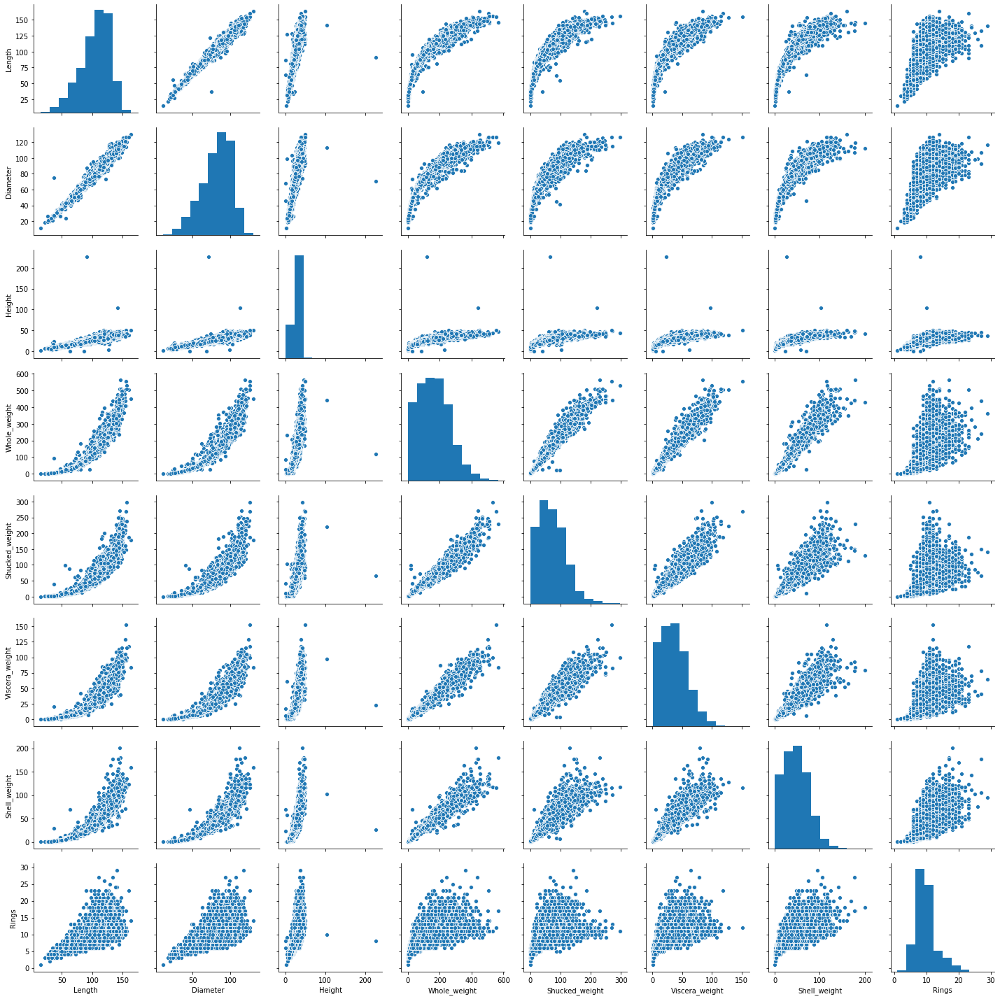

In [16]:
plt.figure(figsize=(12,10))
sns.pairplot(df.iloc[:, :-3]) 

1) Length and Diameter are linear correlated.

2)

Q3: Generate the scatterplot

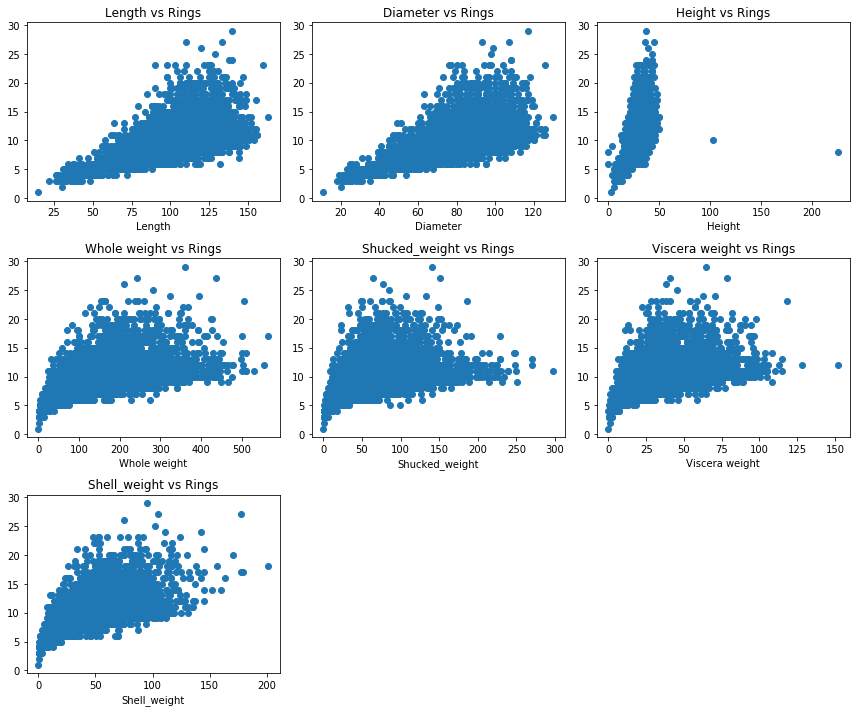

In [23]:
plt.figure(figsize=(12, 10))

plt.subplot(3,3,1)
plt.title('Length vs Rings')
plt.xlabel('Length')
plt.scatter(df['Length'], df['Rings'])

plt.subplot(3,3,2)
plt.title('Diameter vs Rings')
plt.xlabel('Diameter')
plt.scatter(df['Diameter'], df['Rings'])

plt.subplot(3,3,3)
plt.title('Height vs Rings')
plt.xlabel('Height')
plt.scatter(df['Height'], df['Rings'])

plt.subplot(3,3,4)
plt.title('Whole weight vs Rings')
plt.xlabel('Whole weight')
plt.scatter(df['Whole_weight'], df['Rings'])

plt.subplot(3,3,5)
plt.title('Shucked_weight vs Rings')
plt.xlabel('Shucked_weight')
plt.scatter(df['Shucked_weight'], df['Rings'])

plt.subplot(3,3,6)
plt.title('Viscera weight vs Rings')
plt.xlabel('Viscera weight')
plt.scatter(df['Viscera_weight'], df['Rings'])

plt.subplot(3,3,7)
plt.title('Shell_weight vs Rings')
plt.xlabel('Shell_weight')
plt.scatter(df['Shell_weight'], df['Rings'])


plt.tight_layout()

I do not agree with the hypothesis

Q4: Predict with linear regression

In [24]:
from patsy import dmatrices,dmatrix
import statsmodels.api as sm

y, X = dmatrices('Rings ~ Height', data=df, return_type='dataframe')
model = sm.OLS(y, X)
res = model.fit()
res.params

Intercept    3.930856
Height       0.215070
dtype: float64

Q5: scatterplot and linear regression line 

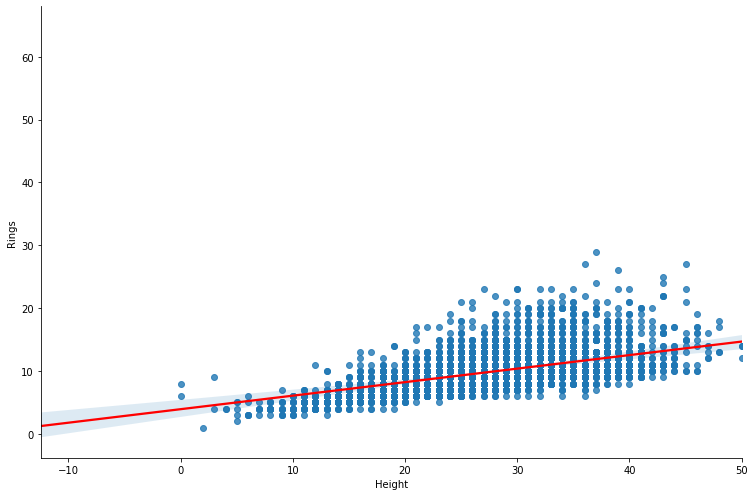

In [25]:
g = sns.lmplot(x="Height", y="Rings", data=df, aspect=1.5,height=7)
g.set(xlim=(None, 50))
regline = g.ax.get_lines()[0]
regline.set_color('red')

Q6: Diagnostics test for linear regression

In [40]:
pred_val = res.fittedvalues.copy()
true_val = df['Rings'].values.copy()
residual = true_val - pred_val

Text(0.5, 1.0, 'histplot of residual')

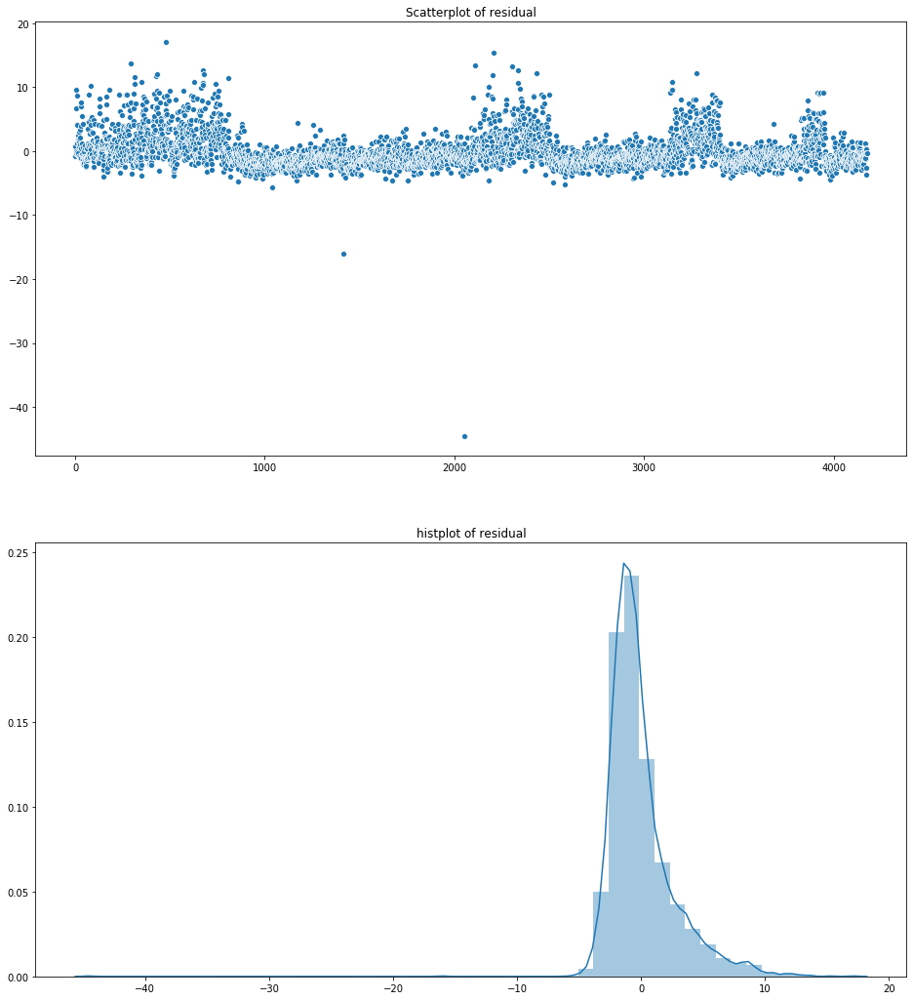

In [59]:
plt.figure(figsize=(16, 18))
plt.subplot(2,1,1)
f1 = sns.scatterplot(x=residual.index, y=residual)
f1.set_title("Scatterplot of residual")
plt.subplot(2,1,2)
f2 = sns.distplot(residual)
f2.set_title("histplot of residual")

It seems like the corresponding residual plot is reasonably random. To confirm that, let’s go with a hypothesis test, Harvey-Collier multiplier test, for linearity

In [82]:
import statsmodels.stats as sms
print(f"p-value of Harvey-Collier test is {sms.api.linear_harvey_collier(res)[1]}")
# print(f"p-value of Harvey-Collier test is {sms.diagnostic.het_breuschpagan(residual, df[['Height', 'Rings']])[1]}")
'''
pval > 0.05, so the model is linear and equal variance. 
'''

p-value of Harvey-Collier test is 2.7876552759672383e-34


'\npval > 0.05, so the model is linear and equal variance. \n'

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Rings   R-squared:                       0.311
Model:                            OLS   Adj. R-squared:                  0.311
Method:                 Least Squares   F-statistic:                     1888.
Date:                Sun, 08 Nov 2020   Prob (F-statistic):               0.00
Time:                        16:21:09   Log-Likelihood:                -10034.
No. Observations:                4176   AIC:                         2.007e+04
Df Residuals:                    4174   BIC:                         2.008e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      3.9309      0.144     27.263      0.000       3.648       4.214
Height         0.2151      0.005     43.455      0.000       0.205       0.225
==============================================================================
Omnibus:                     1152.107   Durbin-Watson:                   1.136
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            81884.378
Skew:                           0.363   Prob(JB):                         0.00
Kurtosis:                      24.681   Cond. No.                         102.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

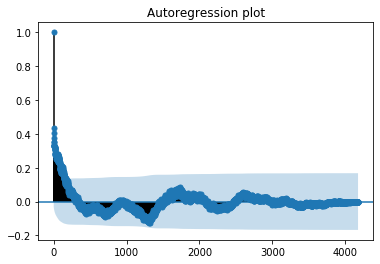

In [66]:
# P4: ACF + Durbin-Watson test
f3 = sm.graphics.tsa.plot_acf(residual, lags=residual.index, title="Autoregression plot")
'''
Durbin-Watson test is 1.136 > 0.05, so the null hypothesus(uncorrelated) can not reject, so the posutlate is validated
'''
res.summary()

p-value of shapiro-wilk test is 0.0


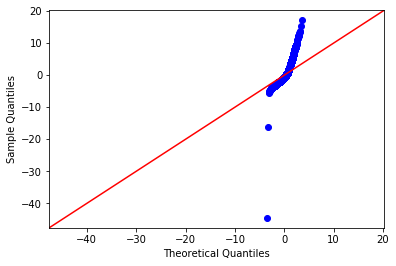

In [81]:
# P4: QQ-plot + shapiro-wilk test
f4 = sm.qqplot(residual, line='45')
'''
Obviously, the residual does not meet gaussian distribution assumption.
'''
from scipy.stats import shapiro
print(f"p-value of shapiro-wilk test is {shapiro(residual)[1]}")
'''
From the output we can see that the test statistic is 0.0 and the corresponding p-value is 0.0. Since the p-value is far less than .05, we reject the null hypothesis.
'''

In [83]:
res.conf_int(0.05, cols=None)
'''
The one percentage change of Height will cause 0.205 ~ 0.224 precentage change in Rings(age). 
'''

,0,1
Intercept,3.648182,4.213530
Height,0.205367,0.224773


In [85]:
# Q8: statistically significant relationship of one factor
'''
Probability of F-statistics is 0.00 which is far less than 0.05, so we reject the null hypothesis(beta1 = 0), and the height and the number of rings (and hence, the age) of abalones are statistically significant
'''
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Rings   R-squared:                       0.311
Model:                            OLS   Adj. R-squared:                  0.311
Method:                 Least Squares   F-statistic:                     1888.
Date:                Sun, 08 Nov 2020   Prob (F-statistic):               0.00
Time:                        17:34:46   Log-Likelihood:                -10034.
No. Observations:                4176   AIC:                         2.007e+04
Df Residuals:                    4174   BIC:                         2.008e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      3.9309      0.144     27.263      0.000       3.648       4.214
Height         0.2151      0.005     43.455      0.000       0.205       0.225
==============================================================================
Omnibus:                     1152.107   Durbin-Watson:                   1.136
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            81884.378
Skew:                           0.363   Prob(JB):                         0.00
Kurtosis:                      24.681   Cond. No.                         102.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""